<figure>
<center>
<img src='https://www.upload.ee/image/16038501/image_2023-12-10_231047378.png'/>
</figure>

<center><h1></h1></center>
<center><h1>Faculty of Engineering and Technology</h1></center>

<center><h1>Electrical and Computer Engineering Department</h1></center>

---

---

<center><h1>ENCS5343 Computer Vision</h1></center>

<center><h1>Assignment #1</h1></center>

<h3>Student name: Ali Mohammed</h3>

<h3>Student ID: 1190502</h3>

**How to run my codes?**

You can run all codes by clicking on the button underlined in red in the following image <img src='https://www.upload.ee/image/16064115/image_2023-12-18_005157134.png'/>. This automatically runs my work.

# Import libraries

In [ ]:
!pip3 install opencv-python

In [ ]:
!pip3 install scikit-image

In [ ]:
!pip3 install numpy

In [ ]:
!git clone https://github.com/amohd63/Datasets.git

In [2]:
!mkdir outputs

# Quetsion#1

Look for an image from the internet with the following properties: 8-bit gray-level, 256x256 pixels in size.

1. Show this image. Don’t use your friends’ ones.
2. Apply a power law transformation with gamma=0.4 to the image and show
the image after the transformation.
3. Add a zero-mean Gaussian noise (with variance =40 gray-levels) to the
original image and show the resulting image.
4. Apply a 5 by 5 mean filter to the noisy-image you obtained in point 3 above
and show the result. Discuss the results in your report.
5. Add salt and pepper noise (noise-density=0.1) to the original image and then apply a 7 by 7 median filter to the noisy-image and show both images.
6. Apply a 7 by 7 mean filter to the salt and pepper noisy-image and show the result. Discuss the results in your report.
7. Apply a Sobel filter to the original image and show the response (don’t use ready functions to do this part).



In [3]:
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
from skimage.util import random_noise
import matplotlib.pyplot as plt
import imgaug.augmenters as iaa

## 1. Displaying the image

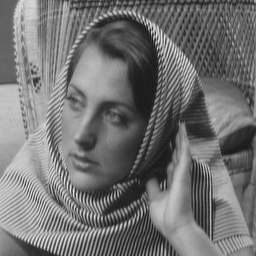

In [4]:
img = cv2.imread(r'Datasets/CS-Images/Q1_2.ppm')
img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
cv2_imshow(img)

This is the proposed image for this question.

## 2. Apply power law transformation

There are two ways applied on the image, but both gave the same result.

Text(0.5, 1.0, 'After power low transformation')

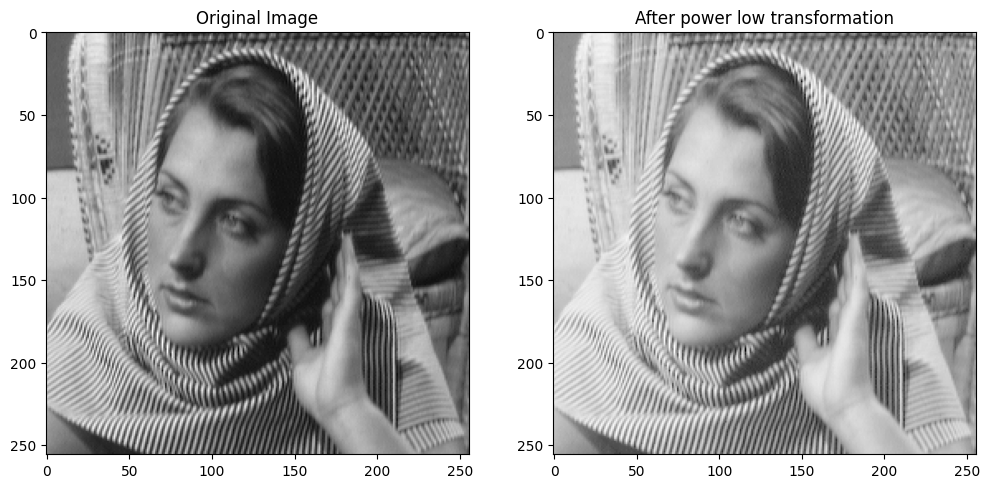

In [5]:
gamma = 0.4
transformed_img = np.array(255.0*(img/255.0)**gamma,dtype='uint8')

fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(transformed_img, cmap='gray')
ax[1].set_title('After power low transformation')

Text(0.5, 1.0, 'After power low transformation')

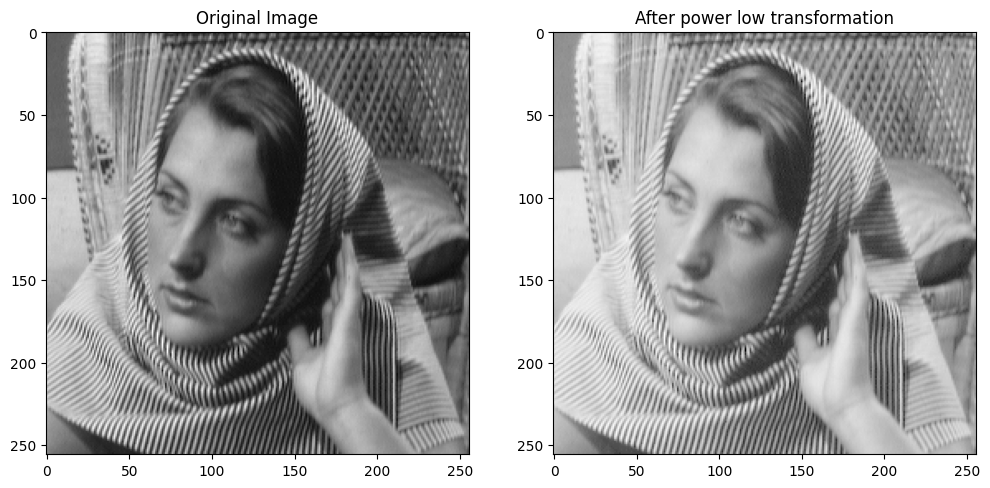

In [6]:
gamma = 0.4
transformed_img = cv2.pow(img/1.0, gamma)

fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(transformed_img, cmap='gray')
ax[1].set_title('After power low transformation')

Power-law transformations uses gamma to correct image's luminance. As well as, for gamma less than 1 (our case), the brightness of the image is increased, which is clear in the displayed images.

## Add gaussian noise

Text(0.5, 1.0, 'Image with Gaussian Noise')

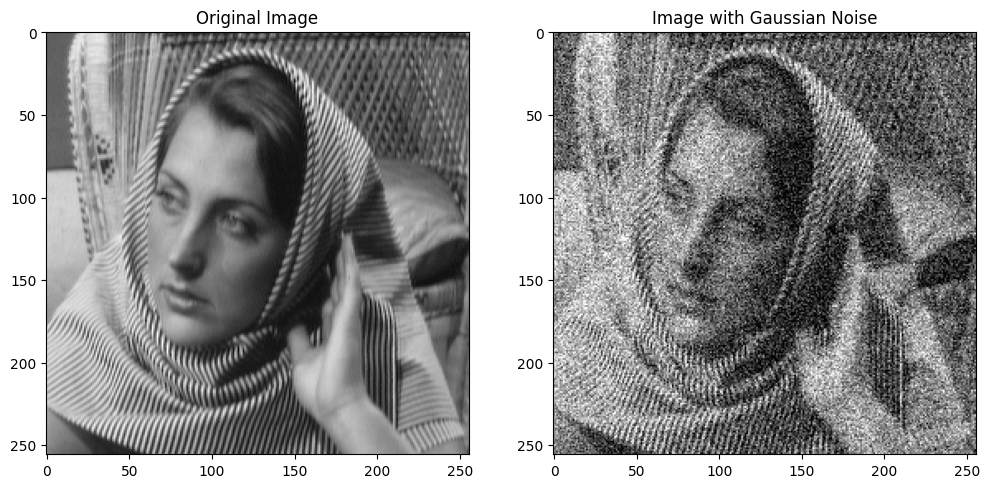

In [ ]:
# Define mean and variance for Gaussian noise
mean = 0
var = 40

# Add Gaussian noise
noise = np.random.normal(mean, var, img.shape)
noisy_image = img + noise

# Clip pixel values to [0, 255]
g_noised_image = np.clip(noisy_image, 0, 255)

fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(g_noised_image, cmap='gray')
ax[1].set_title('Image with Gaussian Noise')

Gaussian noise shows up as little specks scattered across the image. These specks can be brighter or darker than the surrounding pixels, depending on the random change. The image became grainy, obscuring the original information.

The following code, is another way of adding gaussian noise. Both ways look the same.

Text(0.5, 1.0, 'Image with Gaussian Noise')

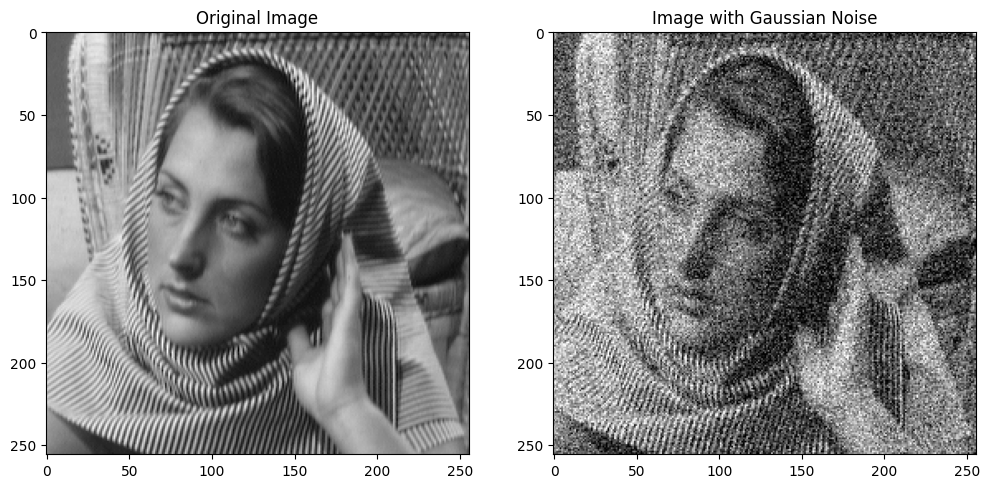

In [ ]:
g_noised_image = random_noise(img, mode='gaussian', mean=0, var=0.025)

fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(g_noised_image, cmap='gray')
ax[1].set_title('Image with Gaussian Noise')

## Apply mean filter

Mean filters work by averaging the values of neighboring pixels. This can effectively smooth out noise, but it also blurs sharp edges and fine details in the image. The level of blurring depends on the filter size - larger filters lead to greater smoothing but also more detail loss.

Text(0.5, 1.0, 'Image After Mean filter')

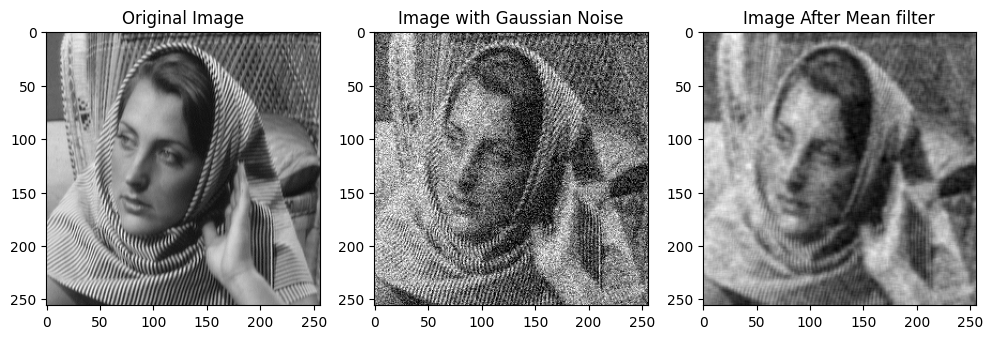

In [ ]:
mean_img = cv2.blur(g_noised_image, (5, 5))

fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(g_noised_image, cmap='gray')
ax[1].set_title('Image with Gaussian Noise')
ax[2].imshow(mean_img, cmap='gray')
ax[2].set_title('Image After Mean filter')

This step conisder filtering the imgae after adding gaussian noise to it. The mean filter is used for this purpose. However, the mean filter is senstivie to the noise, so it fails to recover the image, which is shown in the 3rd image.

## Add salt and pepper noise & apply median filter

Text(0.5, 1.0, 'Image after Median filter')

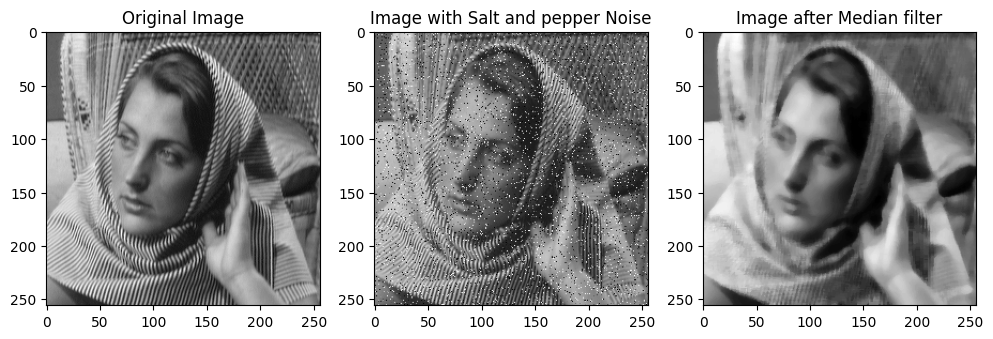

In [ ]:
aug = iaa.SaltAndPepper(p=0.1)
sp_noised_image = aug.augment_image(img)
median_img = cv2.medianBlur(sp_noised_image, 7)

fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(sp_noised_image, cmap='gray')
ax[1].set_title('Image with Salt and pepper Noise')
ax[2].imshow(median_img, cmap='gray')
ax[2].set_title('Image after Median filter')

This task includes adding salt and pepper noise to the original image and applying median filter to it. The median filter is less sensitive to noise (outliers), so it is clear that it succeded in recovering the original image with some loss in the original information.

## Apply mean filter

Text(0.5, 1.0, 'Image after Mean filter')

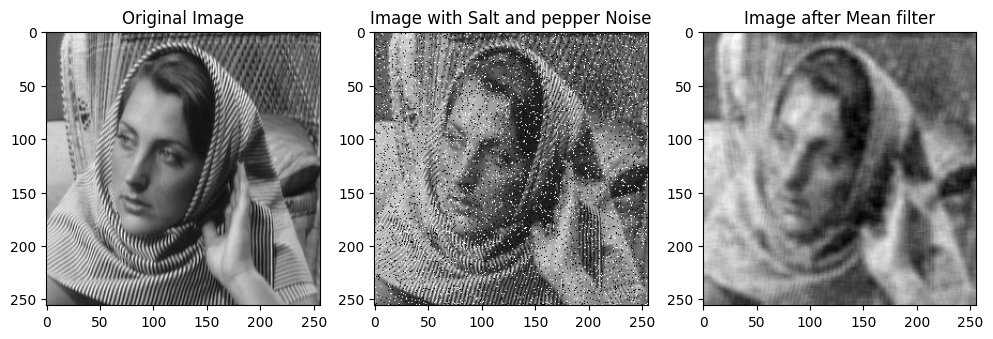

In [ ]:
mean_img = cv2.blur(sp_noised_image, (7, 7))

fig, ax = plt.subplots(nrows=1,ncols=3, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(sp_noised_image, cmap='gray')
ax[1].set_title('Image with Salt and pepper Noise')
ax[2].imshow(mean_img, cmap='gray')
ax[2].set_title('Image after Mean filter')

This task includes adding salt and pepper noise to the original image and applying mean filter to it. The mean filter is sensitive to noise (outliers). So, it is clear that the mean filter is not capable of recovering all details.

**In comparison**, median filter result is better than the mean which is very clear in the previous steps. However, this ensures the sensitivity of each one to noise (outliers).

## Apply sobel filter

This part considers implementing the algorithm of sobel filter.

The used kernels are mentioned in the course slides, as well as the implementation steps.

Text(0.5, 1.0, 'After Sobel filter')

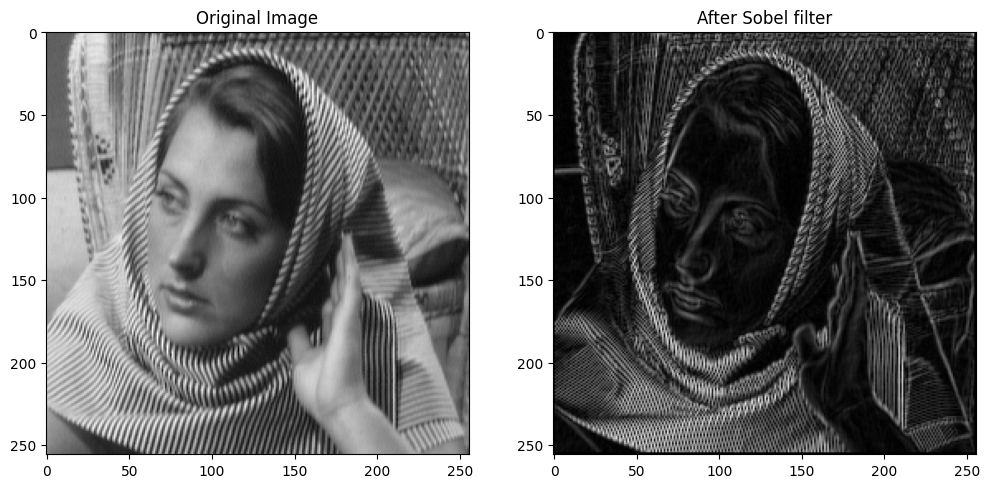

In [ ]:
Gy = np.array([[-1.0,  0.0,  1.0],
               [-2.0,  0.0,  2.0],
               [-1.0,  0.0,  1.0]])

Gx = np.array([[-1.0, -2.0, -1.0],
               [ 0.0,  0.0,  0.0],
               [ 1.0,  2.0,  1.0]])

rows, columns = img.shape
sobel_filtered_image = np.zeros(shape=(rows, columns))

for i in range(rows - 2):
    for j in range(columns - 2):
        gx = np.sum(np.multiply(Gx, img[i:i + 3, j:j + 3]))
        gy = np.sum(np.multiply(Gy, img[i:i + 3, j:j + 3]))
        sobel_filtered_image[i + 1, j + 1] = abs(gx) + abs(gy)

fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(sobel_filtered_image, cmap='gray')
ax[1].set_title('After Sobel filter')

It is clear that sobel detected all eddges, woman details; face, hand, and hijab. And, the other edges on the background (chair edges). It works good.

To confirm our implementation, we used the OpenCV sobel implementation.

Text(0.5, 1.0, 'After Sobel filter')

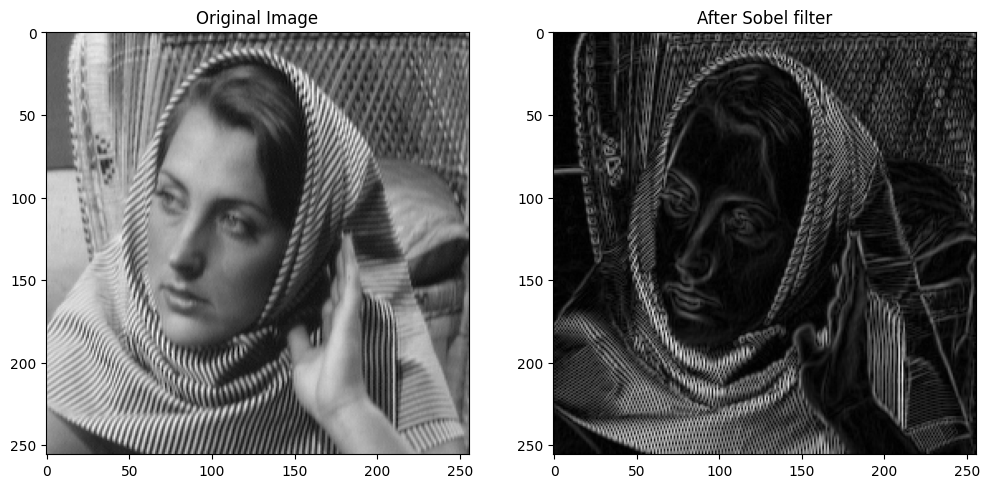

In [ ]:
gradient_x = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=3) # Sobel Edge Detection on the X axis
gradient_y = cv2.Sobel(src=img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=3) # Sobel Edge Detection on the Y axis

gradient_magnitude, _ = cv2.cartToPolar(gradient_x, gradient_y, angleInDegrees=False)
fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(12,6))
ax = ax.ravel()
ax[0].imshow(img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(gradient_magnitude, cmap='gray')
ax[1].set_title('After Sobel filter')

The results are the same, which indicates the correctness of our implementation.

# Quetsion#2

Write a function that convolves an image with a given convolution filter

<center>$function$ $[output$_$Image]= myImageFilter(Input$_$image, filter)$</center>

Your function should output image of the same size as that of input Image (use padding). Test your function (on attached images “House1.jpg” and “House2.jpg”) and show results on the following Kernels.

1. Averaging Kernel (3×3 and 5×5 )
2. Gaussian Kernel (σ = 1,2,3) Use (2σ +1)×(2σ +1) as size of Kernel (You may write a separate function to generate Gaussian Kernels for different values of σ). Discuss the results in your report.
3. Sobel Edge Operators:
<figure>
<center>
<img src='https://www.upload.ee/image/16038508/image_2023-12-10_231212549.png' />
</figure>
4. Prewitt Edge Operators:  
<figure>
<center>
<img src='https://www.upload.ee/image/16038514/image_2023-12-10_231306683.png' />
</figure>

## First solution: using built-in functions

### Applying averaging kernels on two images.

Text(0.5, 1.0, 'House2 after 5x5 averaging kernel')

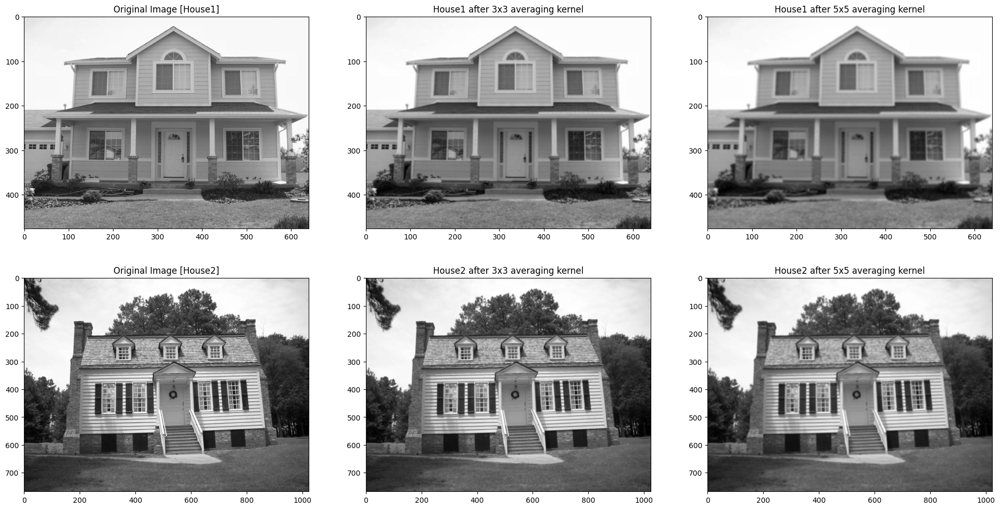

In [ ]:
house1 = cv2.imread(r'Datasets/CS-Images/House1.jpg', 0)
house2 = cv2.imread(r'Datasets/CS-Images/House2.jpg', 0)

mean_house1_3 = cv2.blur(house1, (3, 3))
mean_house1_5 = cv2.blur(house1, (5, 5))
mean_house2_3 = cv2.blur(house2, (3, 3))
mean_house2_5 = cv2.blur(house2, (5, 5))

fig, ax = plt.subplots(nrows=2,ncols=3, figsize=(24,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(mean_house1_3, cmap='gray')
ax[1].set_title('House1 after 3x3 averaging kernel')
ax[2].imshow(mean_house1_5, cmap='gray')
ax[2].set_title('House1 after 5x5 averaging kernel')

ax[3].imshow(house2, cmap='gray')
ax[3].set_title('Original Image [House2]')
ax[4].imshow(mean_house2_3, cmap='gray')
ax[4].set_title('House2 after 3x3 averaging kernel')
ax[5].imshow(mean_house2_5, cmap='gray')
ax[5].set_title('House2 after 5x5 averaging kernel')

For both images, as long as the size of the kernel increases, the blurring becomes clearer in the filtered images.

### Applying gaussian kernels

Text(0.5, 1.0, 'House2 after 7x7 gaussian kernel (σ = 3)')

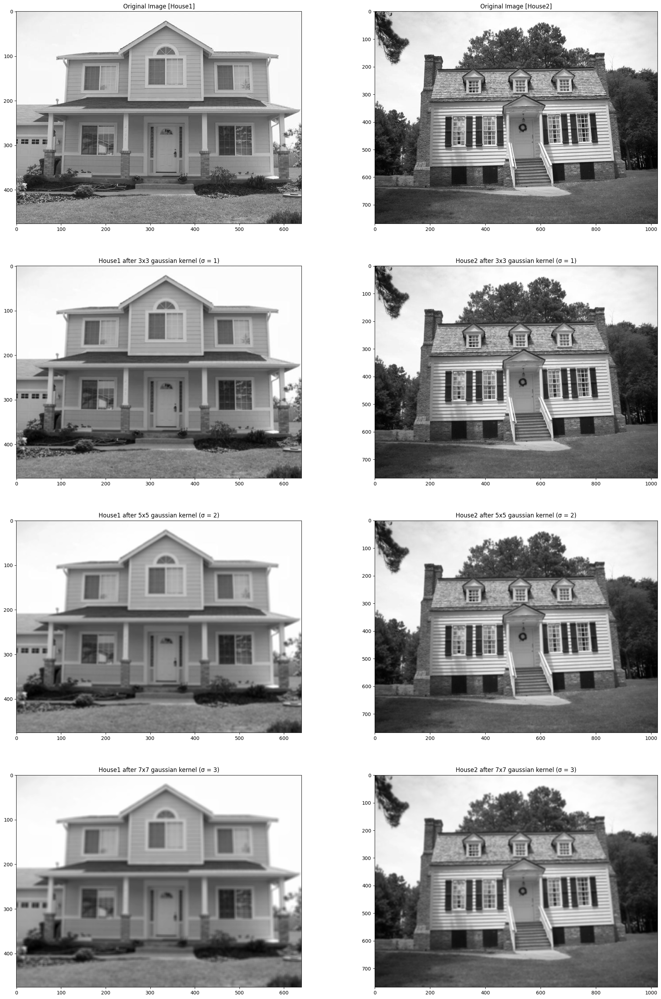

In [ ]:
house1 = cv2.imread(r'Datasets/CS-Images/House1.jpg', 0)
house2 = cv2.imread(r'Datasets/CS-Images/House2.jpg', 0)

gaussian_house1_3 = cv2.GaussianBlur(house1,(3,3),cv2.BORDER_DEFAULT)
gaussian_house1_5 = cv2.GaussianBlur(house1,(5,5),cv2.BORDER_DEFAULT)
gaussian_house1_7 = cv2.GaussianBlur(house1,(7,7),cv2.BORDER_DEFAULT)

gaussian_house2_3 = cv2.GaussianBlur(house2,(3,3),cv2.BORDER_DEFAULT)
gaussian_house2_5 = cv2.GaussianBlur(house2,(5,5),cv2.BORDER_DEFAULT)
gaussian_house2_7 = cv2.GaussianBlur(house2,(7,7),cv2.BORDER_DEFAULT)

fig, ax = plt.subplots(nrows=4,ncols=2, figsize=(24,36))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(house2, cmap='gray')
ax[1].set_title('Original Image [House2]')

ax[2].imshow(gaussian_house1_3, cmap='gray')
ax[2].set_title('House1 after 3x3 gaussian kernel (σ = 1)')
ax[3].imshow(gaussian_house2_3, cmap='gray')
ax[3].set_title('House2 after 3x3 gaussian kernel (σ = 1)')

ax[4].imshow(gaussian_house1_5, cmap='gray')
ax[4].set_title('House1 after 5x5 gaussian kernel (σ = 2)')
ax[5].imshow(gaussian_house2_5, cmap='gray')
ax[5].set_title('House2 after 5x5 gaussian kernel (σ = 2)')

ax[6].imshow(gaussian_house1_7, cmap='gray')
ax[6].set_title('House1 after 7x7 gaussian kernel (σ = 3)')
ax[7].imshow(gaussian_house2_7, cmap='gray')
ax[7].set_title('House2 after 7x7 gaussian kernel (σ = 3)')

The gaussian filter adds blur layer as shown in the images above, as long as the kernel size increases, the opacity of the blurring layer increases.

### Applying sobel edge operators

In [ ]:
# Sobel Edge Detection
h1_gradient_x = cv2.Sobel(src=house1, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=3) # Sobel Edge Detection on the X axis
h1_gradient_y = cv2.Sobel(src=house1, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=3) # Sobel Edge Detection on the Y axis

h1_gradient_magnitude, _ = cv2.cartToPolar(h1_gradient_x, h1_gradient_y, angleInDegrees=False)

h2_gradient_x = cv2.Sobel(src=house2, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=3) # Sobel Edge Detection on the X axis
h2_gradient_y = cv2.Sobel(src=house2, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=3) # Sobel Edge Detection on the Y axis

h2_gradient_magnitude, _ = cv2.cartToPolar(h2_gradient_x, h2_gradient_y, angleInDegrees=False)

I used this snippet of code to solve the problem I faced in displaying the images of **Gx** and **Gy**. I will use it in all parts of sobel and prewitt.

In [ ]:
cv2.imwrite('outputs/h1_gradient_x.jpg', h1_gradient_x)
h1_gradient_x = cv2.imread(r'outputs/h1_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h1_gradient_y.jpg', h1_gradient_y)
h1_gradient_y = cv2.imread(r'outputs/h1_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_x.jpg', h2_gradient_x)
h2_gradient_x = cv2.imread(r'outputs/h2_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_y.jpg', h2_gradient_y)
h2_gradient_y = cv2.imread(r'outputs/h2_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

Text(0.5, 1.0, 'Edges of House2 (|Gx| + |Gy|)')

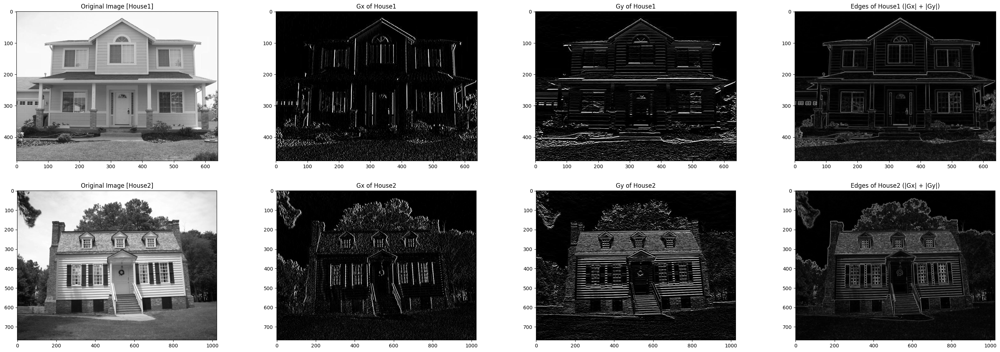

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(36,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(h1_gradient_x, cmap='gray')
ax[1].set_title('Gx of House1')
ax[2].imshow(h1_gradient_y, cmap='gray')
ax[2].set_title('Gy of House1')
ax[3].imshow(h1_gradient_magnitude, cmap='gray')
ax[3].set_title('Edges of House1 (|Gx| + |Gy|)')

ax[4].imshow(house2, cmap='gray')
ax[4].set_title('Original Image [House2]')
ax[5].imshow(h2_gradient_x, cmap='gray')
ax[5].set_title('Gx of House2')
ax[6].imshow(h2_gradient_y, cmap='gray')
ax[6].set_title('Gy of House2')
ax[7].imshow(h2_gradient_magnitude, cmap='gray')
ax[7].set_title('Edges of House2 (|Gx| + |Gy|)')

As previously said, the sobel edge operators detects the edges of the input images. In our case, it detected all important edges in both images.

### Applying prewitt edge operators

In [ ]:
kernelx = np.array([[-1,  0, 1],
                    [-1,  0, 1],
                    [-1,  0, 1]])
kernely = np.array([[ 1,  1, 1],
                    [ 0,  0, 0],
                    [-1, -1, -1]])

h1_gradient_x = cv2.filter2D(house1, cv2.CV_32F, kernelx)
h1_gradient_y = cv2.filter2D(house1, cv2.CV_32F, kernely)

h1_gradient_magnitude = abs(h1_gradient_x) + abs(h1_gradient_y)

h2_gradient_x = cv2.filter2D(house2, cv2.CV_32F, kernelx)
h2_gradient_y = cv2.filter2D(house2, cv2.CV_32F, kernely)

h2_gradient_magnitude = abs(h2_gradient_x) + abs(h2_gradient_y)

In [ ]:
cv2.imwrite('outputs/h1_gradient_x.jpg', h1_gradient_x)
h1_gradient_x = cv2.imread(r'outputs/h1_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h1_gradient_y.jpg', h1_gradient_y)
h1_gradient_y = cv2.imread(r'outputs/h1_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_x.jpg', h2_gradient_x)
h2_gradient_x = cv2.imread(r'outputs/h2_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_y.jpg', h2_gradient_y)
h2_gradient_y = cv2.imread(r'outputs/h2_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

Text(0.5, 1.0, 'Edges of House2 (|Gx| + |Gy|)')

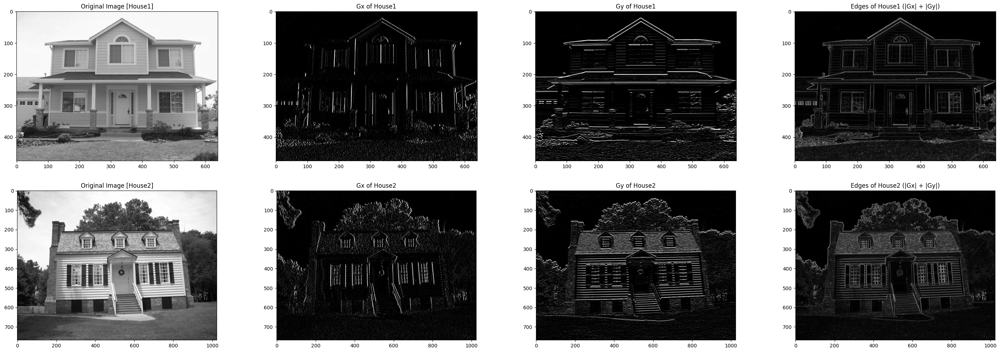

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(36,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(h1_gradient_x, cmap='gray')
ax[1].set_title('Gx of House1')
ax[2].imshow(h1_gradient_y, cmap='gray')
ax[2].set_title('Gy of House1')
ax[3].imshow(h1_gradient_magnitude, cmap='gray')
ax[3].set_title('Edges of House1 (|Gx| + |Gy|)')

ax[4].imshow(house2, cmap='gray')
ax[4].set_title('Original Image [House2]')
ax[5].imshow(h2_gradient_x, cmap='gray')
ax[5].set_title('Gx of House2')
ax[6].imshow(h2_gradient_y, cmap='gray')
ax[6].set_title('Gy of House2')
ax[7].imshow(h2_gradient_magnitude, cmap='gray')
ax[7].set_title('Edges of House2 (|Gx| + |Gy|)')

The prewitt edge operator also detects the edges. But, the edges are clearer in the sobel part (if you zoom the pictures).

## Second solution: implementing myImageFilter(input_image, filter)

This is the implemented function

In [ ]:
def myImageFilter(input_image, filter, depth=cv2.CV_32F):
  return cv2.filter2D(input_image, depth, filter)

In [ ]:
house1 = cv2.imread(r'Datasets/CS-Images/House1.jpg', 0)
house2 = cv2.imread(r'Datasets/CS-Images/House2.jpg', 0)

### Averaging part

Text(0.5, 1.0, 'House2 after 5x5 averaging kernel')

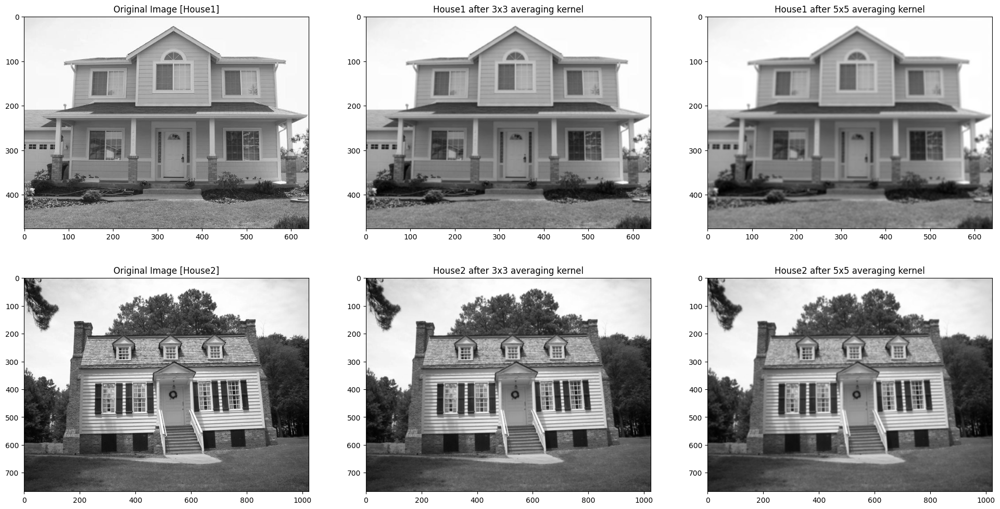

In [ ]:
kernel_3x3 = np.ones((3, 3)) / 9
kernel_5x5 = np.ones((5, 5)) / 25

mean_house1_3 = myImageFilter(house1, kernel_3x3)
mean_house1_5 = myImageFilter(house1, kernel_5x5)
mean_house2_3 = myImageFilter(house2, kernel_3x3)
mean_house2_5 = myImageFilter(house2, kernel_5x5)

fig, ax = plt.subplots(nrows=2,ncols=3, figsize=(24,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(mean_house1_3, cmap='gray')
ax[1].set_title('House1 after 3x3 averaging kernel')
ax[2].imshow(mean_house1_5, cmap='gray')
ax[2].set_title('House1 after 5x5 averaging kernel')

ax[3].imshow(house2, cmap='gray')
ax[3].set_title('Original Image [House2]')
ax[4].imshow(mean_house2_3, cmap='gray')
ax[4].set_title('House2 after 3x3 averaging kernel')
ax[5].imshow(mean_house2_5, cmap='gray')
ax[5].set_title('House2 after 5x5 averaging kernel')

### Gaussian part

In [ ]:
def gaussian_kernel(sigma):
  sig = 1
  kernel_size = 2*sigma + 1
  kernel = np.zeros(shape=(kernel_size, kernel_size))
  center = kernel_size // 2
  for i in range(kernel_size):
    for j in range(kernel_size):
      x, y = i - center, j - center
      kernel[i][j] = np.sqrt(x**2 + y**2)
  return kernel

Text(0.5, 1.0, 'House2 after 7x7 gaussian kernel (σ = 3)')

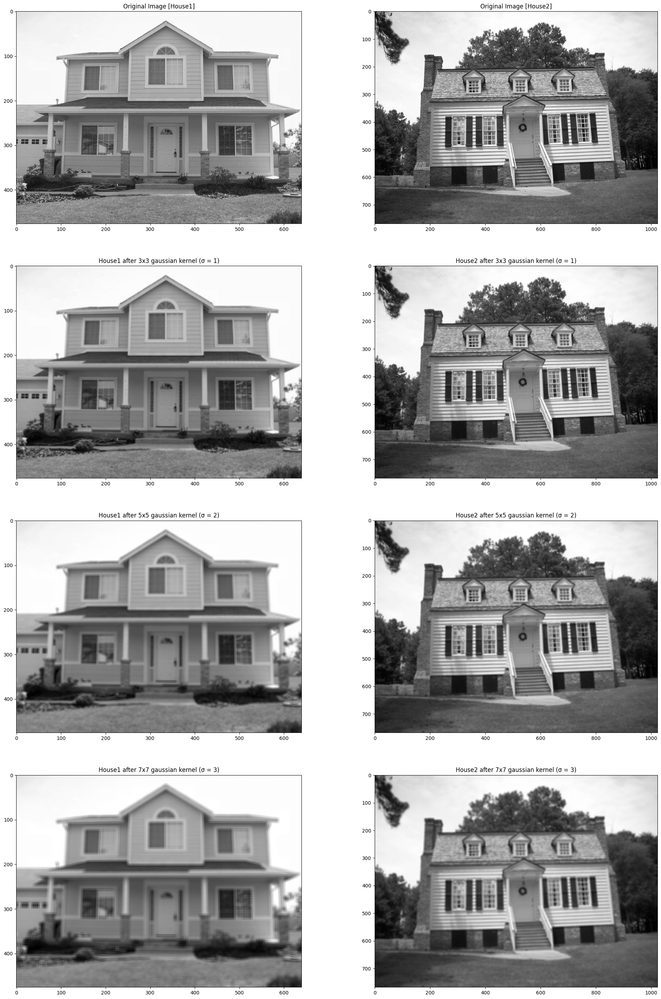

In [ ]:
house1 = cv2.imread(r'Datasets/CS-Images/House1.jpg', 0)
house2 = cv2.imread(r'Datasets/CS-Images/House2.jpg', 0)

kernel_1 = gaussian_kernel(1)
kernel_2 = gaussian_kernel(2)
kernel_3 = gaussian_kernel(3)

gaussian_house1_3 = myImageFilter(house1, kernel_1)
gaussian_house1_5 = myImageFilter(house1, kernel_2)
gaussian_house1_7 = myImageFilter(house1, kernel_3)

gaussian_house2_3 = myImageFilter(house2, kernel_1)
gaussian_house2_5 = myImageFilter(house2, kernel_2)
gaussian_house2_7 = myImageFilter(house2, kernel_3)

fig, ax = plt.subplots(nrows=4,ncols=2, figsize=(24,36))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(house2, cmap='gray')
ax[1].set_title('Original Image [House2]')

ax[2].imshow(gaussian_house1_3, cmap='gray')
ax[2].set_title('House1 after 3x3 gaussian kernel (σ = 1)')
ax[3].imshow(gaussian_house2_3, cmap='gray')
ax[3].set_title('House2 after 3x3 gaussian kernel (σ = 1)')

ax[4].imshow(gaussian_house1_5, cmap='gray')
ax[4].set_title('House1 after 5x5 gaussian kernel (σ = 2)')
ax[5].imshow(gaussian_house2_5, cmap='gray')
ax[5].set_title('House2 after 5x5 gaussian kernel (σ = 2)')

ax[6].imshow(gaussian_house1_7, cmap='gray')
ax[6].set_title('House1 after 7x7 gaussian kernel (σ = 3)')
ax[7].imshow(gaussian_house2_7, cmap='gray')
ax[7].set_title('House2 after 7x7 gaussian kernel (σ = 3)')

### Sobel part

In [ ]:
Gy = np.array([[-1.0,  0.0,  1.0],
               [-2.0,  0.0,  2.0],
               [-1.0,  0.0,  1.0]])

Gx = np.array([[-1.0, -2.0, -1.0],
               [ 0.0,  0.0,  0.0],
               [ 1.0,  2.0,  1.0]])

h1_gradient_x = myImageFilter(house1, Gx)
h1_gradient_y = myImageFilter(house1, Gy)

h1_gradient_magnitude = abs(h1_gradient_x) + abs(h1_gradient_y)

h2_gradient_x = myImageFilter(house2, Gx)
h2_gradient_y = myImageFilter(house2, Gy)

h2_gradient_magnitude = abs(h2_gradient_x) + abs(h2_gradient_y)

In [ ]:
cv2.imwrite('outputs/h1_gradient_x.jpg', h1_gradient_x)
h1_gradient_x = cv2.imread(r'outputs/h1_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h1_gradient_y.jpg', h1_gradient_y)
h1_gradient_y = cv2.imread(r'outputs/h1_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_x.jpg', h2_gradient_x)
h2_gradient_x = cv2.imread(r'outputs/h2_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_y.jpg', h2_gradient_y)
h2_gradient_y = cv2.imread(r'outputs/h2_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

Text(0.5, 1.0, 'Edges of House2 (|Gx| + |Gy|)')

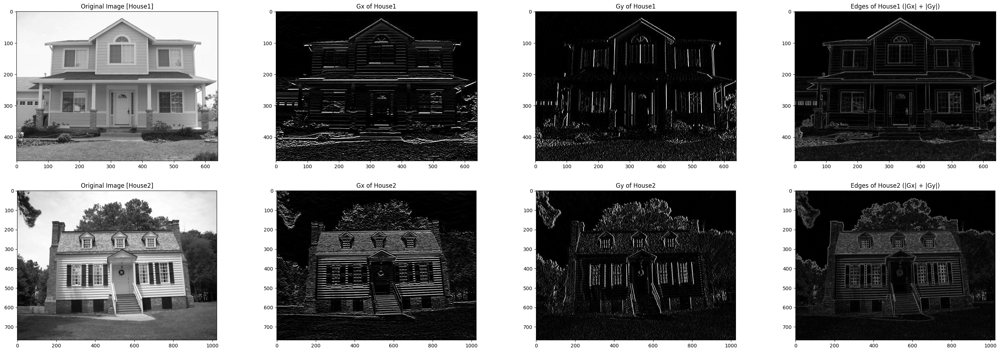

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(36,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(h1_gradient_x, cmap='gray')
ax[1].set_title('Gx of House1')
ax[2].imshow(h1_gradient_y, cmap='gray')
ax[2].set_title('Gy of House1')
ax[3].imshow(h1_gradient_magnitude, cmap='gray')
ax[3].set_title('Edges of House1 (|Gx| + |Gy|)')

ax[4].imshow(house2, cmap='gray')
ax[4].set_title('Original Image [House2]')
ax[5].imshow(h2_gradient_x, cmap='gray')
ax[5].set_title('Gx of House2')
ax[6].imshow(h2_gradient_y, cmap='gray')
ax[6].set_title('Gy of House2')
ax[7].imshow(h2_gradient_magnitude, cmap='gray')
ax[7].set_title('Edges of House2 (|Gx| + |Gy|)')

### Prewitt part

Text(0.5, 1.0, 'Edges of House2 (|Gx| + |Gy|)')

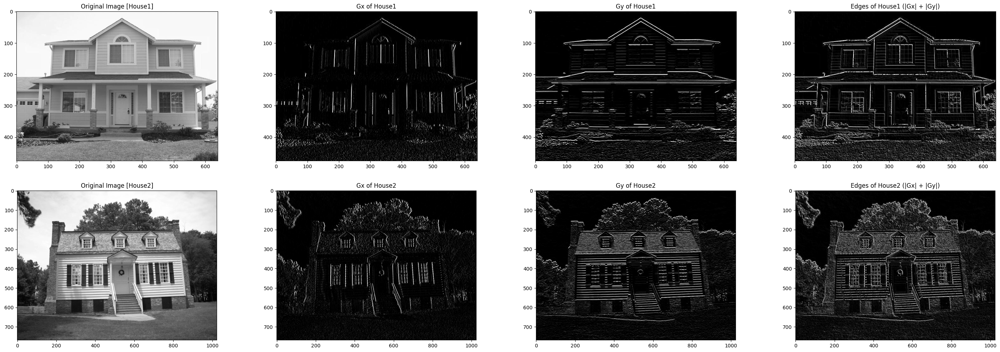

In [ ]:
kernelx = np.array([[-1,  0, 1],
                    [-1,  0, 1],
                    [-1,  0, 1]])
kernely = np.array([[ 1,  1, 1],
                    [ 0,  0, 0],
                    [-1, -1, -1]])

h1_gradient_x = myImageFilter(house1, kernelx)
h1_gradient_y = myImageFilter(house1, kernely)

h1_gradient_magnitude = abs(h1_gradient_x) + abs(h1_gradient_y)

h2_gradient_x = myImageFilter(house2, kernelx)
h2_gradient_y = myImageFilter(house2, kernely)

h2_gradient_magnitude = abs(h2_gradient_x) + abs(h2_gradient_y)

In [ ]:
cv2.imwrite('outputs/h1_gradient_x.jpg', h1_gradient_x)
h1_gradient_x = cv2.imread(r'outputs/h1_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h1_gradient_y.jpg', h1_gradient_y)
h1_gradient_y = cv2.imread(r'outputs/h1_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_x.jpg', h2_gradient_x)
h2_gradient_x = cv2.imread(r'outputs/h2_gradient_x.jpg', cv2.IMREAD_GRAYSCALE)

cv2.imwrite('outputs/h2_gradient_y.jpg', h2_gradient_y)
h2_gradient_y = cv2.imread(r'outputs/h2_gradient_y.jpg', cv2.IMREAD_GRAYSCALE)

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=4, figsize=(36,12))
ax = ax.ravel()
ax[0].imshow(house1, cmap='gray')
ax[0].set_title('Original Image [House1]')
ax[1].imshow(h1_gradient_x, cmap='gray')
ax[1].set_title('Gx of House1')
ax[2].imshow(h1_gradient_y, cmap='gray')
ax[2].set_title('Gy of House1')
ax[3].imshow(h1_gradient_magnitude, cmap='gray')
ax[3].set_title('Edges of House1 (|Gx| + |Gy|)')

ax[4].imshow(house2, cmap='gray')
ax[4].set_title('Original Image [House2]')
ax[5].imshow(h2_gradient_x, cmap='gray')
ax[5].set_title('Gx of House2')
ax[6].imshow(h2_gradient_y, cmap='gray')
ax[6].set_title('Gy of House2')
ax[7].imshow(h2_gradient_magnitude, cmap='gray')
ax[7].set_title('Edges of House2 (|Gx| + |Gy|)')

# Quetsion#3

Attached “Noisyimage1” and “Noisyimage2” are corrupted by salt and paper noise. Apply 5 by 5 Averaging and Median filter and show your outputs. Why Median filter works better than averaging filter?

Text(0.5, 1.0, 'Median filter')

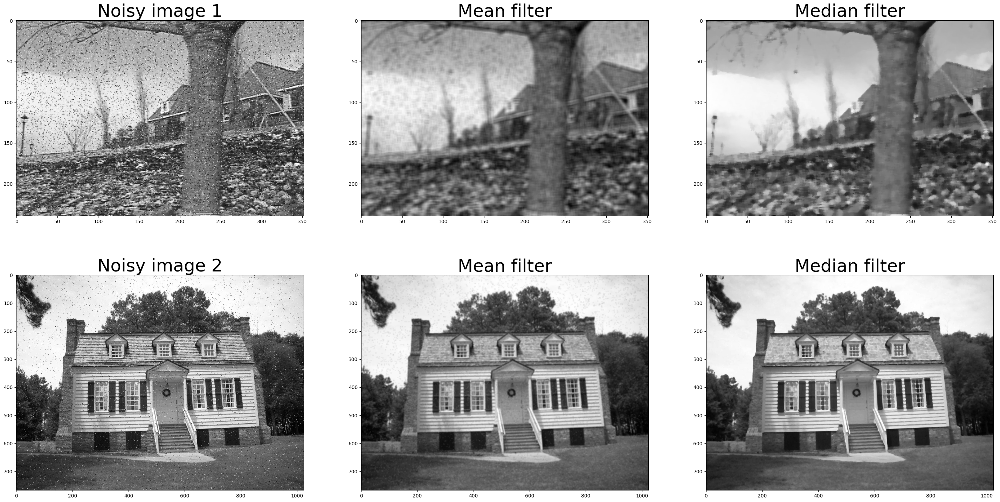

In [ ]:
n_img1 = cv2.imread(r'Datasets/CS-Images/Noisyimage1.jpg', 0)
n_img2 = cv2.imread(r'Datasets/CS-Images/Noisyimage2.jpg', 0)

mean_f_imgs = [cv2.blur(n_img1, (5, 5)),
              cv2.blur(n_img2, (5, 5))]

median_f_imgs = [cv2.medianBlur(n_img1, 5),
              cv2.medianBlur(n_img2, 5)]

fig, ax = plt.subplots(nrows=2,ncols=3, figsize=(36,18))
ax = ax.ravel()
ax[0].imshow(n_img1, cmap='gray')
ax[0].set_title('Noisy image 1', fontsize=36)
ax[1].imshow(mean_f_imgs[0], cmap='gray')
ax[1].set_title('Mean filter', fontsize=36)
ax[2].imshow(median_f_imgs[0], cmap='gray')
ax[2].set_title('Median filter', fontsize=36)

ax[3].imshow(n_img2, cmap='gray')
ax[3].set_title('Noisy image 2', fontsize=36)
ax[4].imshow(mean_f_imgs[1], cmap='gray')
ax[4].set_title('Mean filter', fontsize=36)
ax[5].imshow(median_f_imgs[1], cmap='gray')
ax[5].set_title('Median filter', fontsize=36)

1. Robustness to Outliers:

 * Averaging filters: Outliers, like highly bright or dark pixels in an image, can significantly skew the average value, creating artifacts and distorting the underlying signal.

 * Median filters: The median is less sensitive to outliers because it ranks the data and chooses the middle value. This minimizes the influence of extreme values on the filtered result.

2. Impulse Noise Removal:

 * Averaging filters: Spread impulse noise (e.g., salt-and-pepper noise) across the neighboring pixels, blurring the image and failing to remove the noise effectively.

 * Median filters: Replace noise pixels with the median within the window, effectively removing the isolated noise points without compromising the original signal.

 In both examples, it is obvious that  the median filter recovered the original image, without lossing a lot of information. However, we still see some pixels of the salt and papper noise after applying mean filter.

 To sum up, median filter is not sensitive to outliers as mean.

# Quetsion#4

Compute gradient magnitude for attached image “Q4_Image” (using built-in sobel gradients function).

1. Stretch the resulting magnitude (between 0 to 255) for better visualization
2. Compute the histogram of gradient magnitude
3. Compute gradient orientation (the angle of gradient vector)
4. Compute histogram of gradient orientation (angle between 0 and 2*pi)

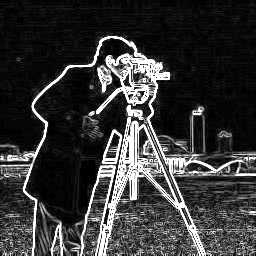

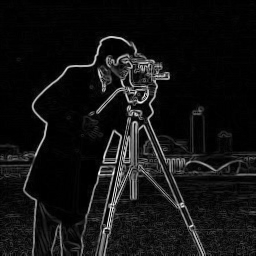

In [ ]:
Q4_img = cv2.imread(r'Datasets/CS-Images/Q_4.jpg', 0)

gradient_x = cv2.Sobel(src=Q4_img, ddepth=cv2.CV_64F, dx=1, dy=0, ksize=3) # Sobel Edge Detection on the X axis
gradient_y = cv2.Sobel(src=Q4_img, ddepth=cv2.CV_64F, dx=0, dy=1, ksize=3) # Sobel Edge Detection on the Y axis

# Compute gradient magnitude
gradient_magnitude, _ = cv2.cartToPolar(gradient_x, gradient_y, angleInDegrees=False)

# Stretch the resulting magnitude (between 0 to 255)
gradient_magnitude_normalized = cv2.normalize(gradient_magnitude, None,alpha=255,beta=0,norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

# Compute gradient orientation
_, gradient_orientation = cv2.cartToPolar(gradient_x, gradient_y, angleInDegrees=False)

# Stretch the resulting orientation (between 0 to 2*pi)
gradient_orientation_normalized = cv2.normalize(gradient_orientation, None,alpha=2*np.pi,beta=0,norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

cv2_imshow(gradient_magnitude)
cv2_imshow(gradient_magnitude_normalized)

The first image in the gradient magnitude without stretching, while the second is the stretched image.

The stretched image is more clear and quiet, the sharpness of the edges are reduced.

Text(0, 0.5, 'Frequency')

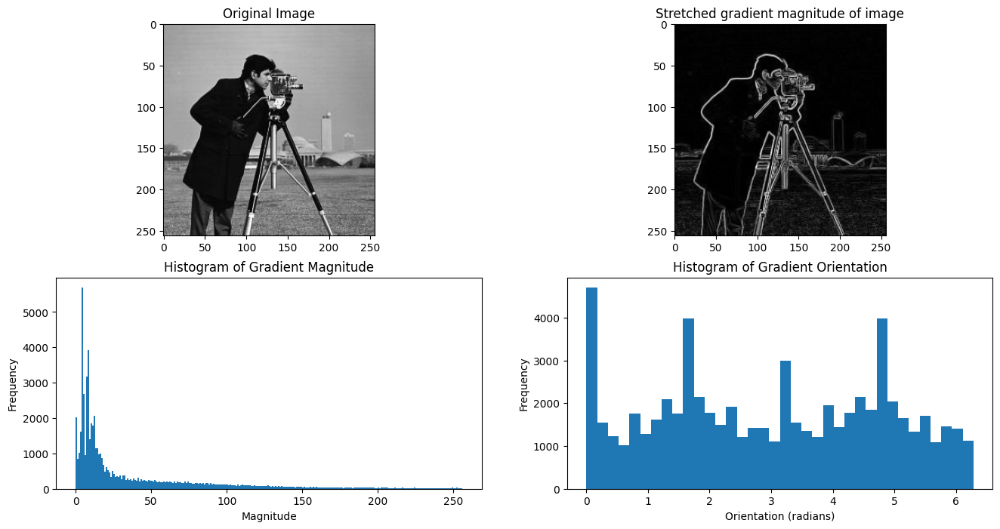

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(16,8))
ax = ax.ravel()
ax[0].imshow(Q4_img, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(gradient_magnitude_normalized, cmap='gray')
ax[1].set_title('Stretched gradient magnitude of image')
ax[2].hist(gradient_magnitude.ravel(), 256, [0, 256])
ax[2].set_title('Histogram of Gradient Magnitude')
ax[2].set_xlabel('Magnitude')
ax[2].set_ylabel('Frequency')
ax[3].hist(gradient_orientation_normalized.ravel(), 36, [0, 2*np.pi])
ax[3].set_title('Histogram of Gradient Orientation')
ax[3].set_xlabel('Orientation (radians)')
ax[3].set_ylabel('Frequency')

There are three things to be discussed:

*   Streteched gradient magnitude: this is the gradient magnitude of sobel operators.

*   Histogram of gradient magnitude: this indicates that most pixels are black or close to black as shown, while the frequency of other magnitudes is small since the percentage of edges with respect to the image is also small.

*   Histogram of gradient orientation: this histogram tracks how many edges are pointing in each direction and the height of each bar in the histogram tells how many edges are pointing in that direction.

# Quetsion#5

Load walk_1.jpg and walk_2.jpg images in Python. Convert them to gray scale and subtract walk_2.jpg from walk_1.jpg. What is the result? Why?

Text(0.5, 1.0, 'Result of [walk1 - walk2]')

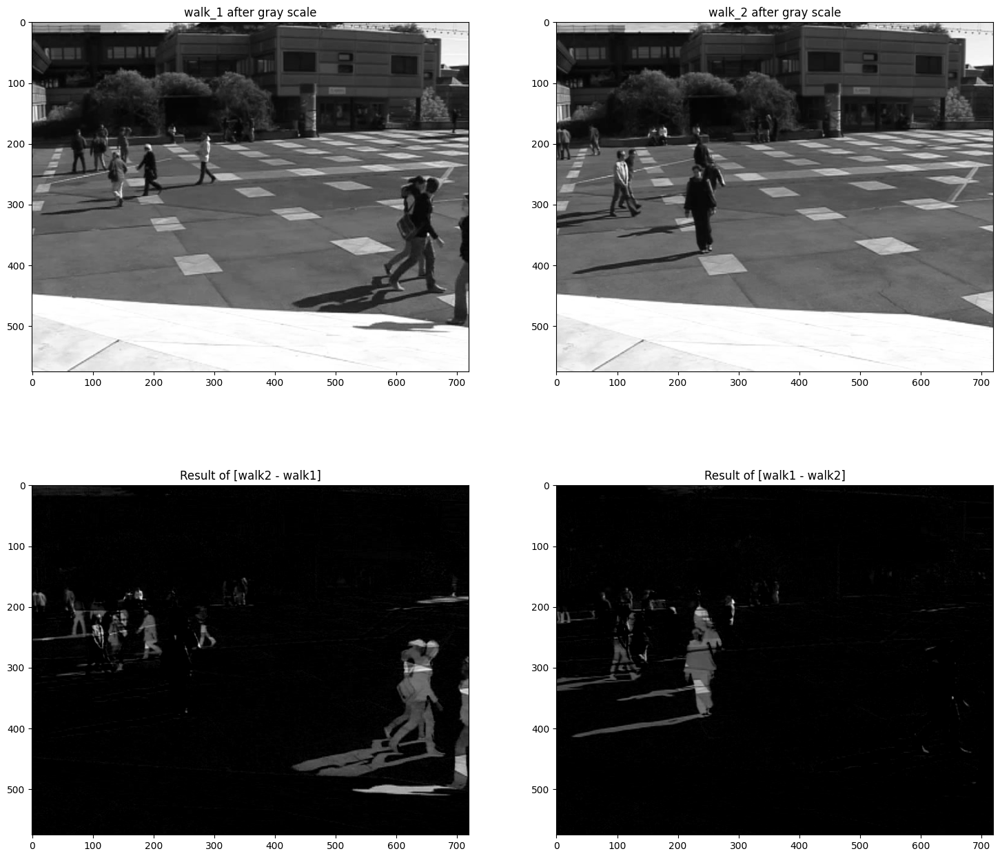

In [18]:
walk_img1 = cv2.imread(r'Datasets/CS-Images/walk_1.jpg')
walk_img2 = cv2.imread(r'Datasets/CS-Images/walk_2.jpg')
walk_img1_gray = cv2.cvtColor(walk_img1, cv2.COLOR_BGR2GRAY)
walk_img2_gray = cv2.cvtColor(walk_img2, cv2.COLOR_BGR2GRAY)

subtracted_w2_w1 = cv2.subtract(walk_img2_gray, walk_img1_gray)
subtracted_w1_w2 = cv2.subtract(walk_img1_gray, walk_img2_gray)

fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(18,16))
ax = ax.ravel()
ax[0].imshow(walk_img1_gray, cmap='gray')
ax[0].set_title('walk_1 after gray scale')
ax[1].imshow(walk_img2_gray, cmap='gray')
ax[1].set_title('walk_2 after gray scale')

ax[2].imshow(subtracted_w2_w1, cmap='gray')
ax[2].set_title('Result of [walk2 - walk1]')
ax[3].imshow(subtracted_w1_w2, cmap='gray')
ax[3].set_title('Result of [walk1 - walk2]')

**What is the result?**

The result of subtraction is object detection. It is used for detecting moving objects.

**Why?**

The black area is shared between the two images, hence the result of subtraction is 0, while 0 is black. However, other objects are not black since they are not common between the two images.

However, the result of (walk1 - walk2) shows the undetected objects from (walk2 - walk1).

# Quetsion#6

Apply canny edge detector on the “Q_4.jpg” using OpenCV function “Canny”. Test different values of ‘Threshold’.

In [ ]:
n_img1 = cv2.imread(r'Datasets/CS-Images/Q_4.jpg', 0)
edge1 = cv2.Canny(n_img1, 0, 50)
edge2 = cv2.Canny(n_img1, 50, 150)
edge3 = cv2.Canny(n_img1, 100, 500)

Text(0.5, 1.0, 'Canny thresholds [100, 500]')

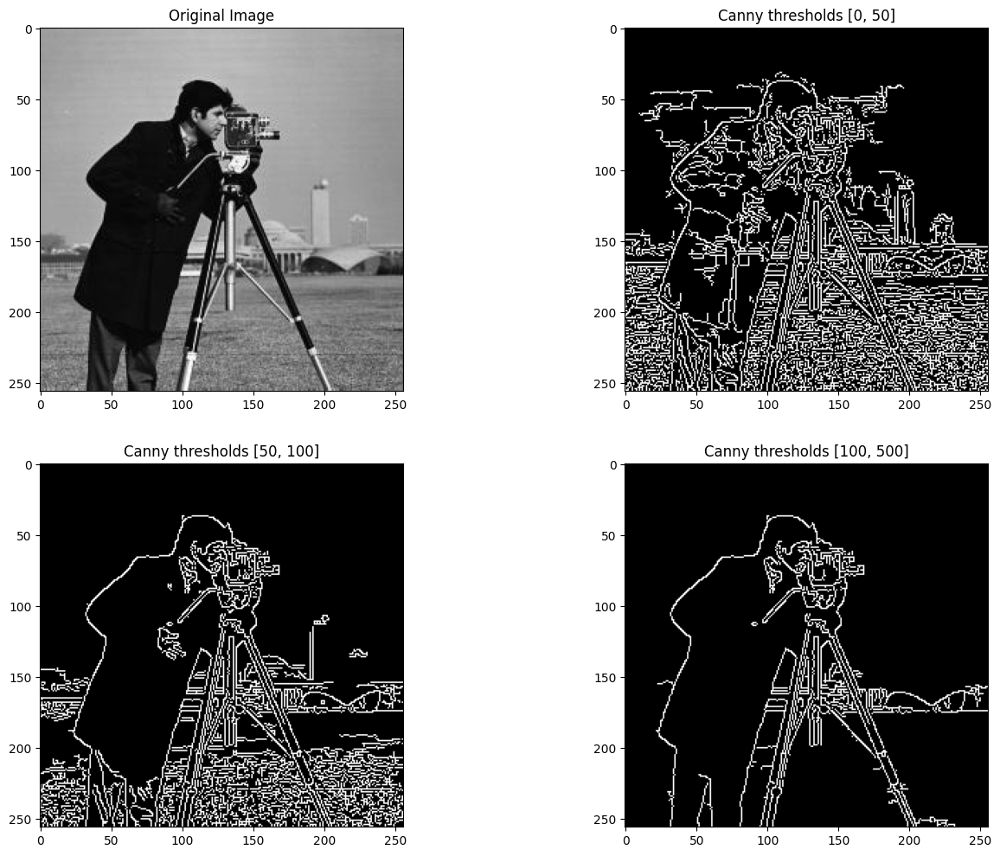

In [ ]:
fig, ax = plt.subplots(nrows=2,ncols=2, figsize=(16,12))
ax = ax.ravel()
ax[0].imshow(n_img1, cmap='gray')
ax[0].set_title('Original Image')
ax[1].imshow(edge1, cmap='gray')
ax[1].set_title('Canny thresholds [0, 50]')
ax[2].imshow(edge2, cmap='gray')
ax[2].set_title('Canny thresholds [50, 100]')
ax[3].imshow(edge3, cmap='gray')
ax[3].set_title('Canny thresholds [100, 500]')

For this part, I used three different ranges for thresholding:

*   [0, 50]: for this range (thresholds), it includes unnecessary edges which are not useful such as the ground and other edges around the cameraman.

*   [50, 100]: as well as for this range, some edges around the man disappered but still the ground edges are detected.

*   [100, 500]: In this range, we can see the man and the camera with the stand are detected along with the bridge.

# References

These are all links I referred to while solving this assignment.

https://dev.to/alcatraz714/opencv-image-processing-using-python-6ma

https://stackoverflow.com/questions/22937589/how-to-add-noise-gaussian-salt-and-pepper-etc-to-image-in-python-with-opencv

https://www.google.com/url?sa=t&rct=j&q=&esrc=s&source=web&cd=&ved=2ahUKEwjKhZHb-YWDAxX9avEDHehNCV8QFnoECBcQAQ&url=https%3A%2F%2Fmedium.com%2F%40betulmesci%2Fimage-processing-tutorial-using-scikit-image-noise-20e181c541a1&usg=AOvVaw0OrzSwdC7HM3HAd-V27uPD&opi=89978449

https://stackoverflow.com/questions/14435632/impulse-gaussian-and-salt-and-pepper-noise-with-opencv

https://www.geeksforgeeks.org/python-opencv-canny-function/

https://blog.finxter.com/how-to-convert-an-image-from-rgb-to-grayscale-in-python/

https://theailearner.com/2019/01/26/power-law-gamma-transformations/

https://stackoverflow.com/questions/59872616/how-to-add-noise-using-skimage

https://www.programcreek.com/python/example/110717/cv2.pow

https://learnopencv.com/edge-detection-using-opencv/

https://www.geeksforgeeks.org/how-to-subtract-two-images-using-python-opencv/

https://github.com/adamiao/sobel-filter-tutorial/blob/master/sobel_from_scratch.py

https://stackoverflow.com/questions/54666507/fast-image-normalisation-in-python

https://www.geeksforgeeks.org/python-opencv-cv2-calchist-method/

https://towardsdev.com/how-to-plot-a-histogram-of-a-grayscale-image-in-2-ways-in-python-using-opencv-e17f1e3e537d

https://learnopencv.com/histogram-of-oriented-gradients/

https://docs.opencv.org/3.0-beta/modules/core/doc/operations_on_arrays.html#carttopolar

https://www.etutorialspoint.com/index.php/308-python-opencv-image-filtering

https://www.tutorialspoint.com/edge-detection-using-prewitt-scharr-and-sobel-operator#:~:text=The%20Prewitt%20operator%20is%20a,image%20intensity%20at%20each%20pixel.

https://docs.opencv.org/4.x/d4/d13/tutorial_py_filtering.html

https://gist.github.com/rahit/c078cabc0a48f2570028bff397a9e154

https://www.coursehero.com/file/12097605/Assignment1V1/